In [4]:
import pandas as pd
import numpy as np

## Ausreisser in Zeitreihen
### Aufgabe 1
In der heutigen Vorlesung haben wir uns mit dem Thema Ausreisser in Zeitreihen beschäftigt. Lade das Datenset data_preoprocessing.csv aus dem Ordner für den heutigen Tag und visualisieren es. Suche nach Ausreissern und verwende dabei dir bekannte Methoden. (Beispielsweise: Z-Score od. Perzentile)

**Wichtig**: Vertraue der Ausreisserbehandlung nicht blind. Übrpüfe vorgeschlagenen Ausreisser händisch und entscheide, ob es sich beim Datenpunkt tatsächlich um einen Ausreisser handelt. 

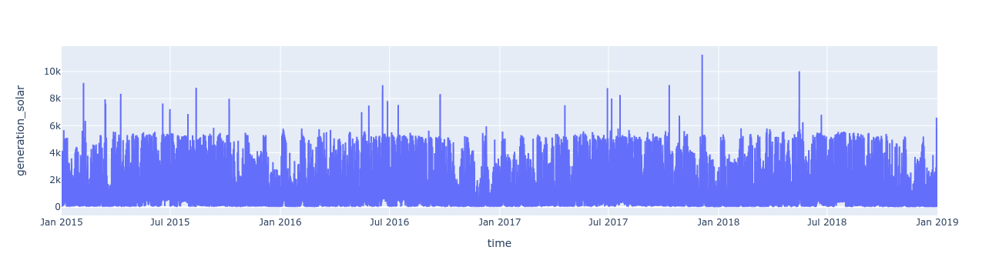

Menge der Ausreiser: 27


In [26]:
df = pd.read_csv("../data/tsa02/data_preprocessing.csv")

import plotly.express as px

fig = px.line(df, x="time", y="generation_solar")
fig.show()

def detect_outliers_zscore(time_series, threshold=2):
    z_scores = (time_series - np.mean(time_series)) / np.std(time_series)
    return np.where(np.abs(z_scores) > threshold)[0]
    
outliers = detect_outliers_zscore(df["generation_solar"], 3)
print("Menge der Ausreiser: {}".format(len(outliers)))

### Aufgabe 1.1
Entferne die Ausreisser und ersetze sie durch NaN-Werte

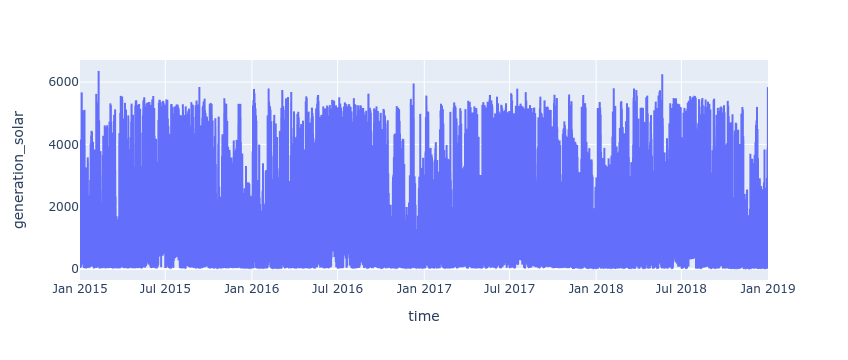

In [27]:
df.loc[outliers, 'generation_solar'] = np.nan
fig = px.line(df, x="time", y="generation_solar")
fig.show()

## Fehlende Werte in der Zeitreihenanalyse

Wie wir bereits kennen gelernt haben, ist es nicht unüblich das Datenpunkte in einem Zeitreihendatenset fehlen. Die Ursachen können vielfältig sein:
- Werte könnten durch Stromausfall nicht aufgezeichnet worden sein
- Ein Produkt in einem Supermarkt war nicht mehr vorrätig und konnte nicht verkauft werden
- Der Laden hatte geschlossen (wegen Streik)
- Der Laden hatte geschlossen (aufgrund von Feiertagen)


Möglichkeiten mittels pandas:
- dropna()
- fillna(0)
- Imputation mittels mean() fillna(MEAN)
- ffill() Forward Fill
- bfill()

### Aufgabe 2

Identifiziere die fehlenden Daten und ersetze die fehlenden Werte mittels der oben gelisteten Pandas Funktionen. 

Erstelle einen Plot für jede Imputationsmethode. Welche eignet sich besser, welche ist eher ungeeignet.

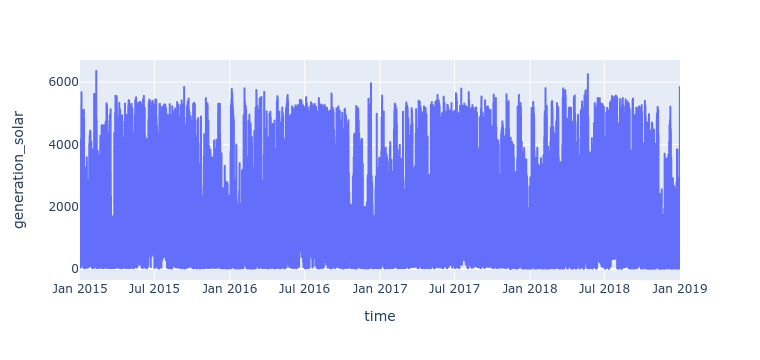

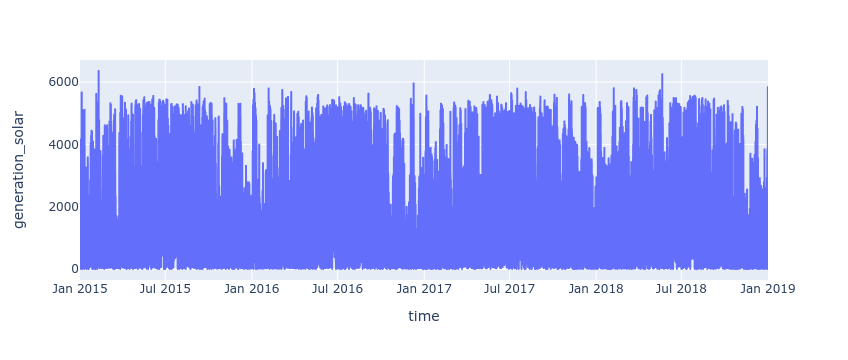

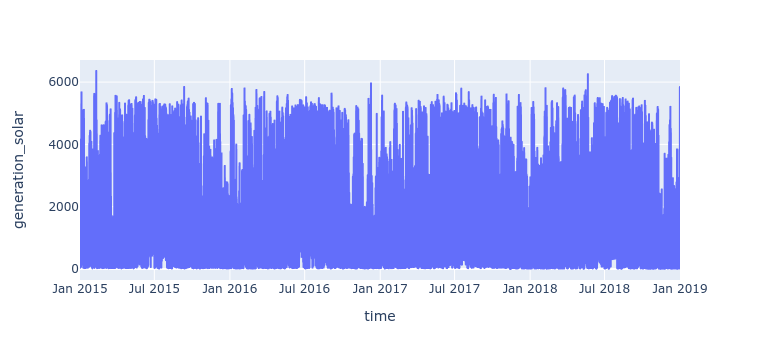

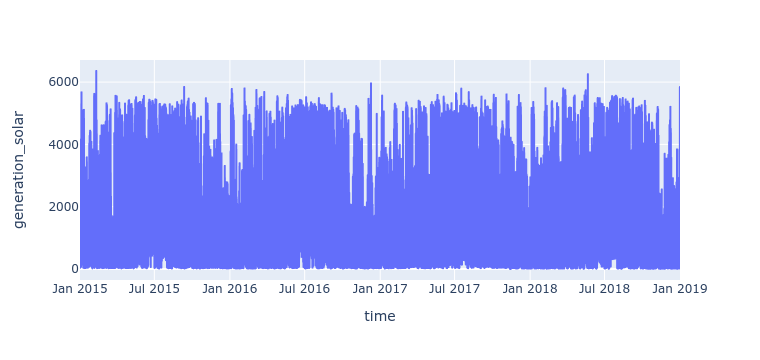

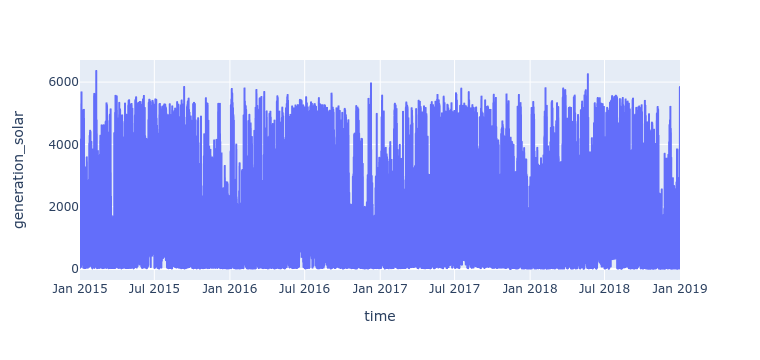

In [32]:
fig_dropna = px.line(df.dropna(), x="time", y="generation_solar")
fig_fillna0 = px.line(df.fillna(0), x="time", y="generation_solar")
fig_fillnamean = px.line(df.fillna(df["generation_solar"].mean()), x="time", y="generation_solar")
fig_ffill = px.line(df.ffill(), x="time", y="generation_solar")
fig_bfill = px.line(df.bfill(), x="time", y="generation_solar")
fig_dropna.show()
fig_fillna0.show()
fig_fillnamean.show()
fig_ffill.show()
fig_bfill.show()

Die vorherigen Methoden haben sich teils als schon ganz brauchbar herausgestellt. Lassen sich einige der Methoden einfach verbessern? Falls ja, wie? Besprecht eure  Lösung mit dem Dozenten und holt euch Feedback.

Implementiere die neue Lösung und visualisiere das Ergebnis der Zeitreihe erneut. 

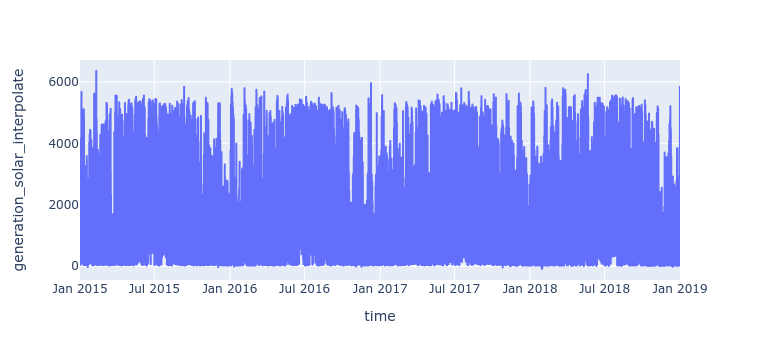

In [39]:
df["generation_solar_interpolate"] = df["generation_solar"].interpolate(method='quadratic')
fig_quadratic_interpolation = px.line(df, x="time", y="generation_solar_interpolate")
fig_quadratic_interpolation.show()

### Aufgabe 3
Oh nein, durch eine defekte Festplatte sind leider die Daten vom **01.07.2018** verloren gegangen. Finde eine geeigne Funktion die Daten zu interpolieren.
- Verwende dazu die pandas Funktion `interpolate`. 
- Identifiziere geeignete Parameter (Funktionen) und plotte erneut.
- Kann eine der Funktionen den Fehlenden Tag vernünftig kompensieren?
-  Gäbe es auch andere Möglichkeiten?

/home/uncreative/miniconda3/envs/summerschool/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



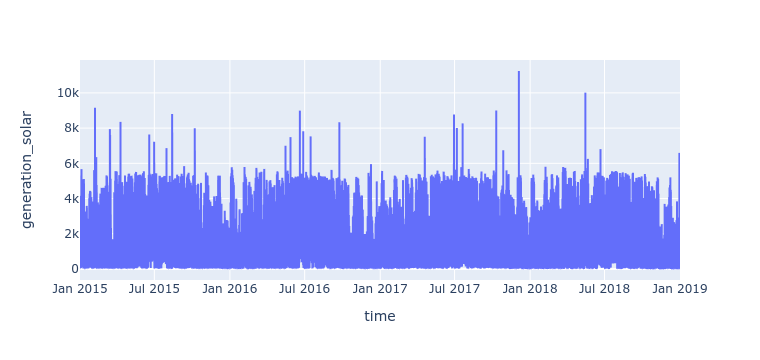

In [51]:
import numpy as np
# Remove some valid values
df = pd.read_csv("../data/tsa02/data_preprocessing.csv")
df['time'] = pd.to_datetime(df['time'])
df.set_index('time', inplace=True)
df.loc[(df.index > "2018-07-01") & (df.index < "2018-07-02"), "generation_solar"] = np.nan
fig = px.line(df, x=df.index, y="generation_solar")
fig.show()

/home/uncreative/miniconda3/envs/summerschool/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



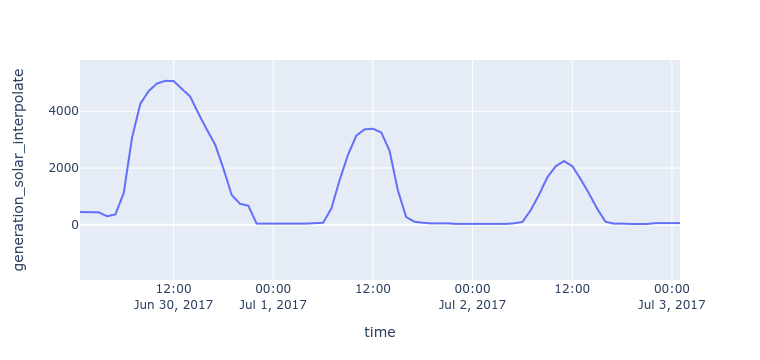

In [47]:
df["generation_solar_interpolate"] = df["generation_solar"].interpolate(method='quadratic')
fig_quadratic_interpolation = px.line(df, x=df.index, y="generation_solar_interpolate")
fig_quadratic_interpolation.show()